#**Yolov11 Player and Ball Detection**

github: @naufalizzuddin

In [ ]:
!nvidia-smi

Fri Nov  8 13:42:09 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   41C    P8               9W /  70W |      0MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

**Step 01 # Install the Ultralytics Package**

In [ ]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 881.2/881.2 kB 27.8 MB/s eta 0:00:00


**Import All Required Libraries**

In [ ]:
import ultralytics
ultralytics.checks()

Ultralytics 8.3.28 🚀 Python-3.10.12 torch-2.5.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 32.3/112.6 GB disk)


In [ ]:
from ultralytics import YOLO
from IPython.display import Image

**Download Dataset from Roboflow**

In [ ]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="5F2Pb2cfyow0ezYvJLLI")
project = rf.workspace("roboflow-jvuqo").project("football-players-detection-bzlaf")
version = project.version(1)
dataset = version.download("yolov11")


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 80.9/80.9 kB 4.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 6.9 MB/s eta 0:00:00
  Attempting uninstall: idna
    Found existing installation: idna 3.10
    Uninstalling idna-3.10:
      Successfully uninstalled idna-3.10
loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to football-players-detection-1 in yolov11:: 100%|██████████| 1132/1132 [00:00<00:00, 2596.11it/s]


In [ ]:
dataset.location

'/content/Foodball-Players-Detection-1'

**Train YOLO11 Model on a Custom Dataset (Football Player and Ball)**

In [ ]:
!yolo task=detect mode=train data={dataset.location}/data.yaml model="yolo11m.pt" epochs=100 imgsz=640 lr0=0.0001 batch=16 optimizer=Adam plots=True


100% 38.8M/38.8M [00:00<00:00, 127MB/s]
Ultralytics 8.3.28 🚀 Python-3.10.12 torch-2.5.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolo11m.pt, data=/content/football-players-detection-1/data.yaml, epochs=100, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=Adam, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False,

In [ ]:
!cp -r /content/runs/detect/train /content/drive/MyDrive/Yolo_V11

**Examine Training Results**

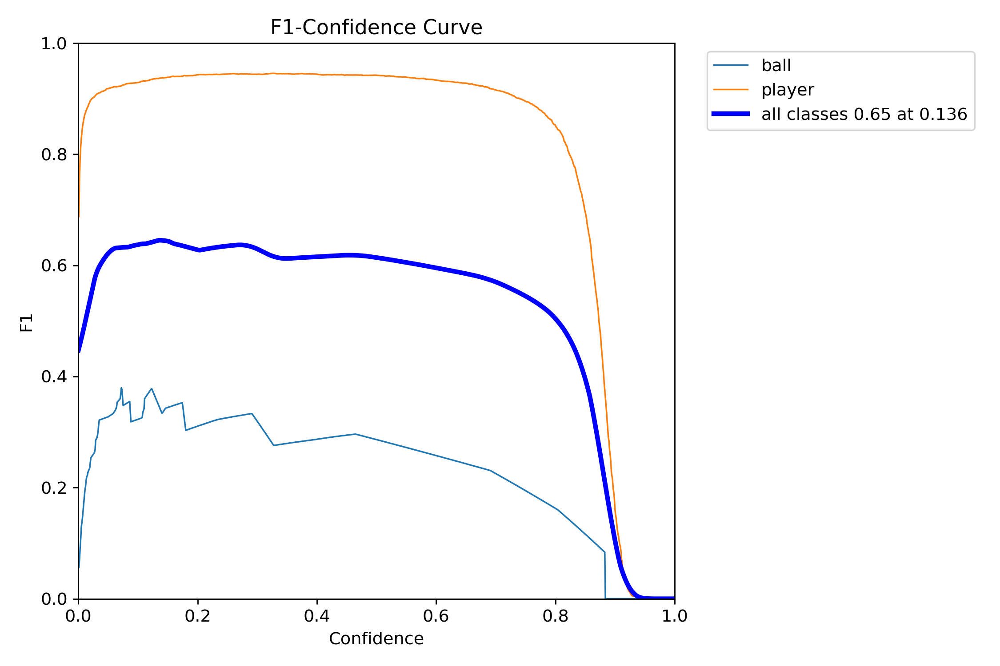

In [ ]:
Image("/content/runs/detect/train/F1_curve.png", width=600)

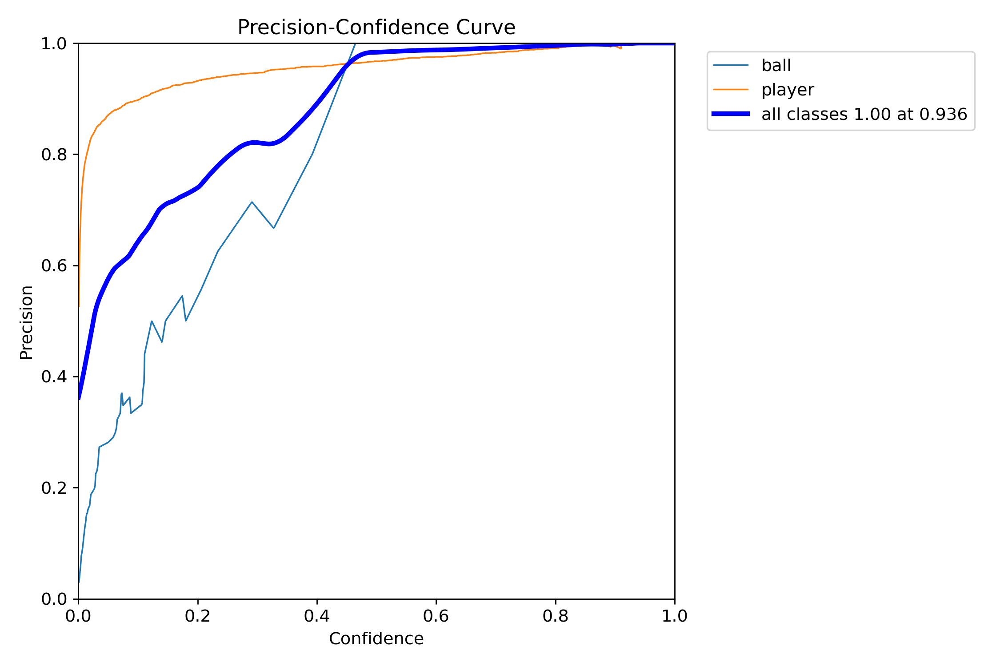

In [ ]:
Image("/content/runs/detect/train/P_curve.png", width=600)

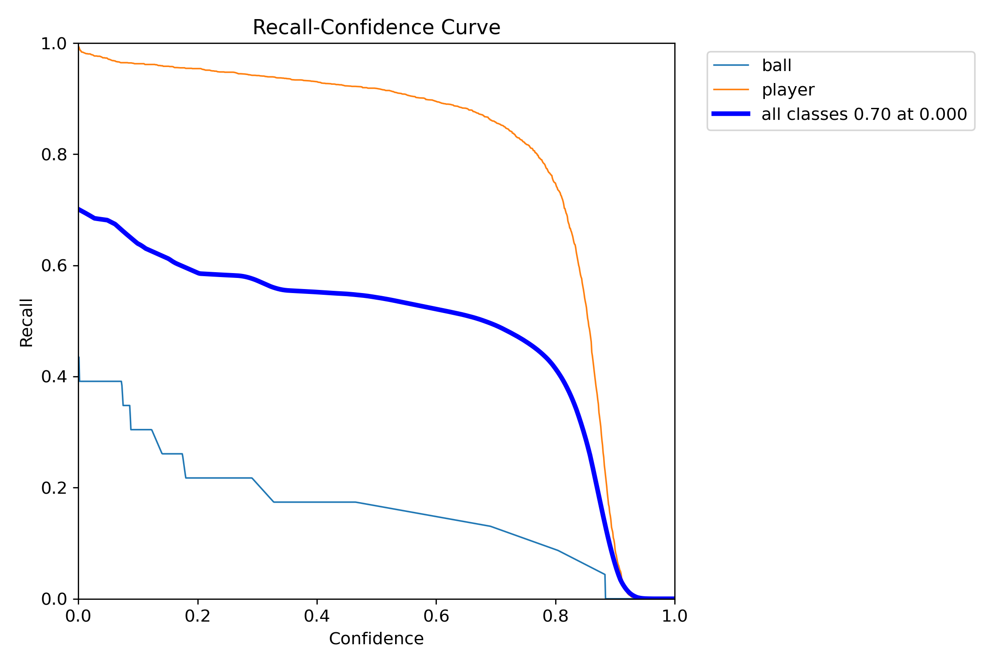

In [ ]:
Image("/content/runs/detect/train/R_curve.png", width=600)

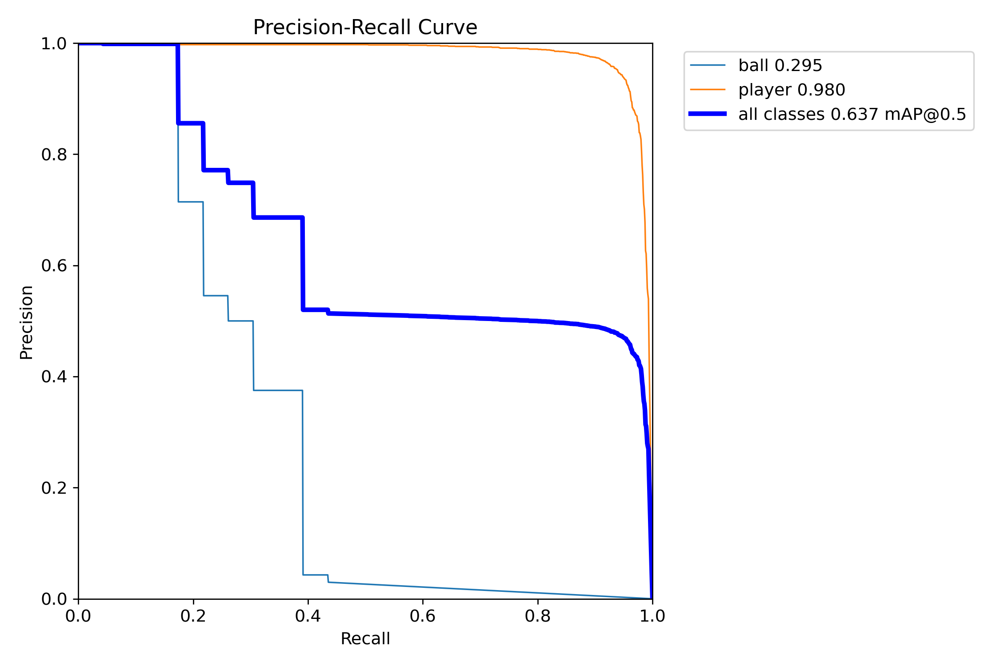

In [ ]:
Image("/content/runs/detect/train/PR_curve.png", width=600)

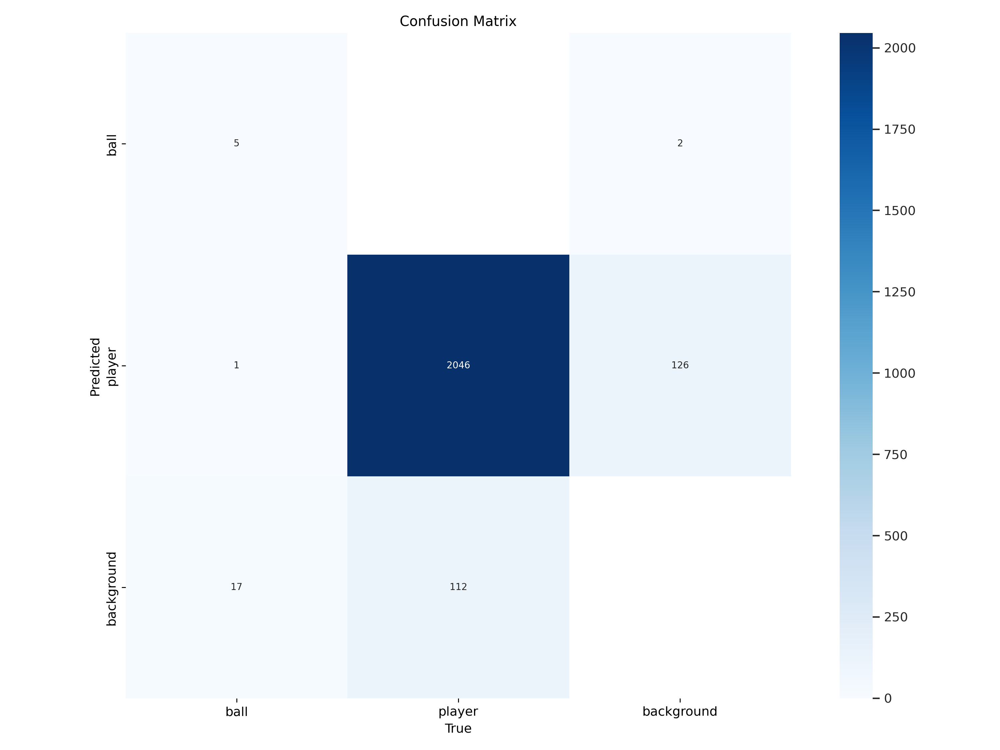

In [ ]:
Image("/content/runs/detect/train/confusion_matrix.png", width=600)

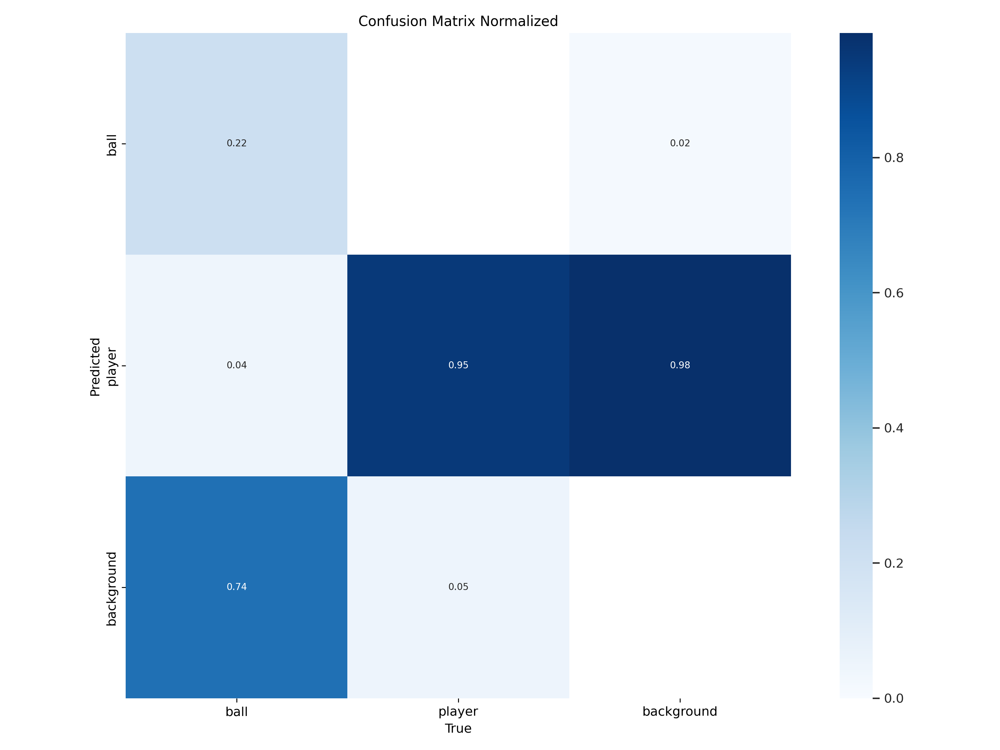

In [ ]:
Image("/content/runs/detect/train/confusion_matrix_normalized.png", width=600)

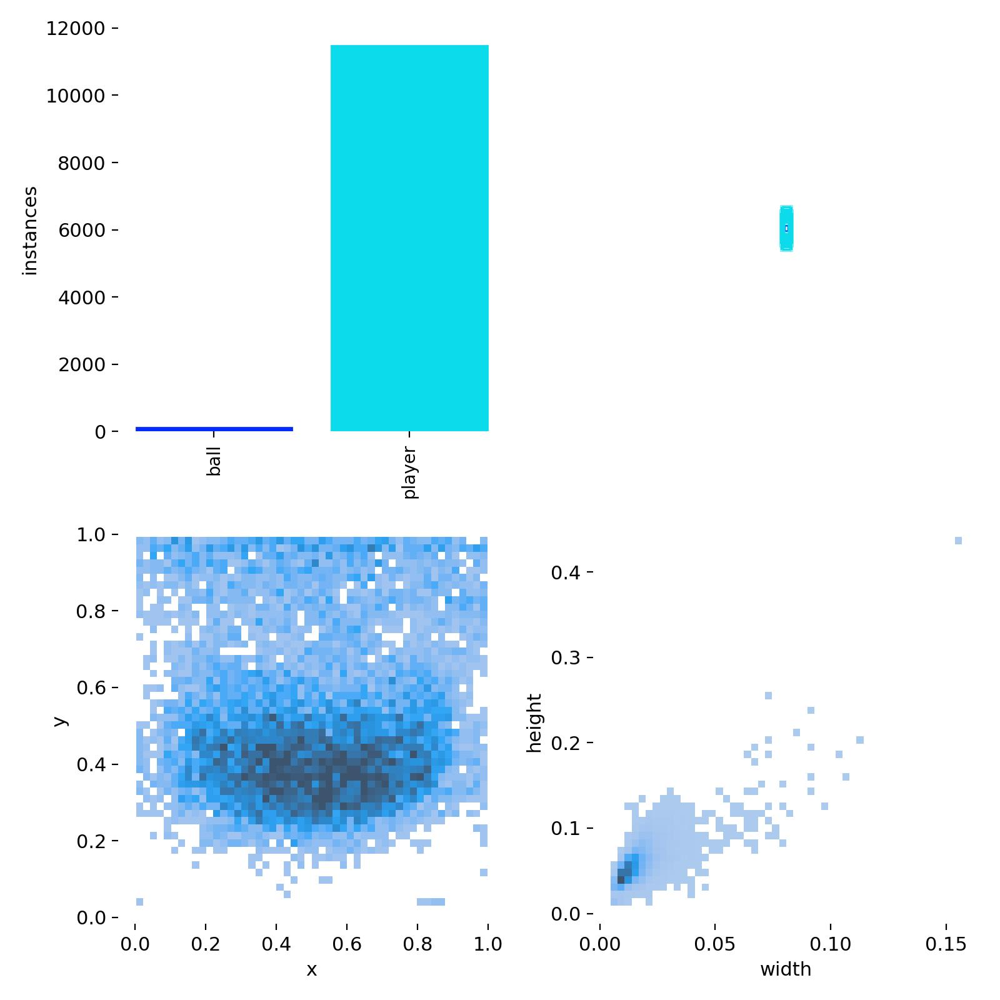

In [ ]:
Image("/content/runs/detect/train/labels.jpg", width=600)

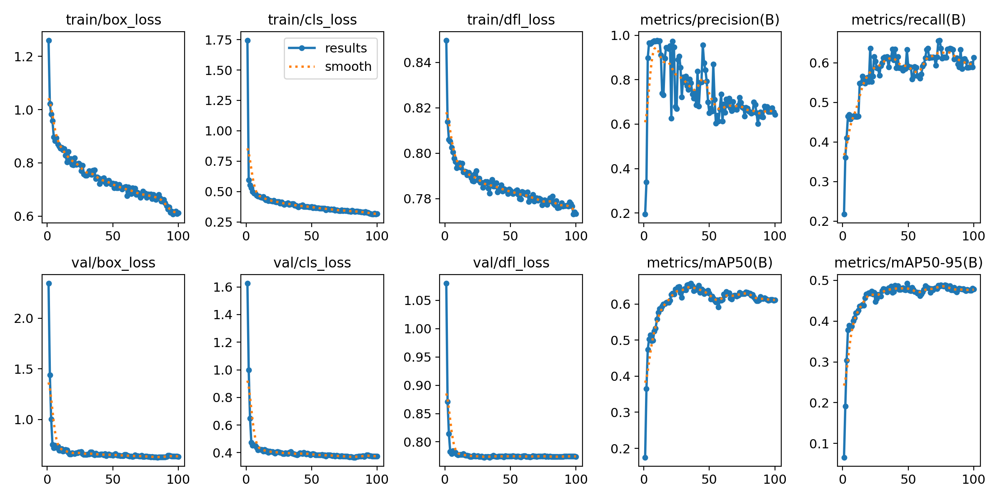

In [ ]:
Image("/content/runs/detect/train/results.png", width=600)

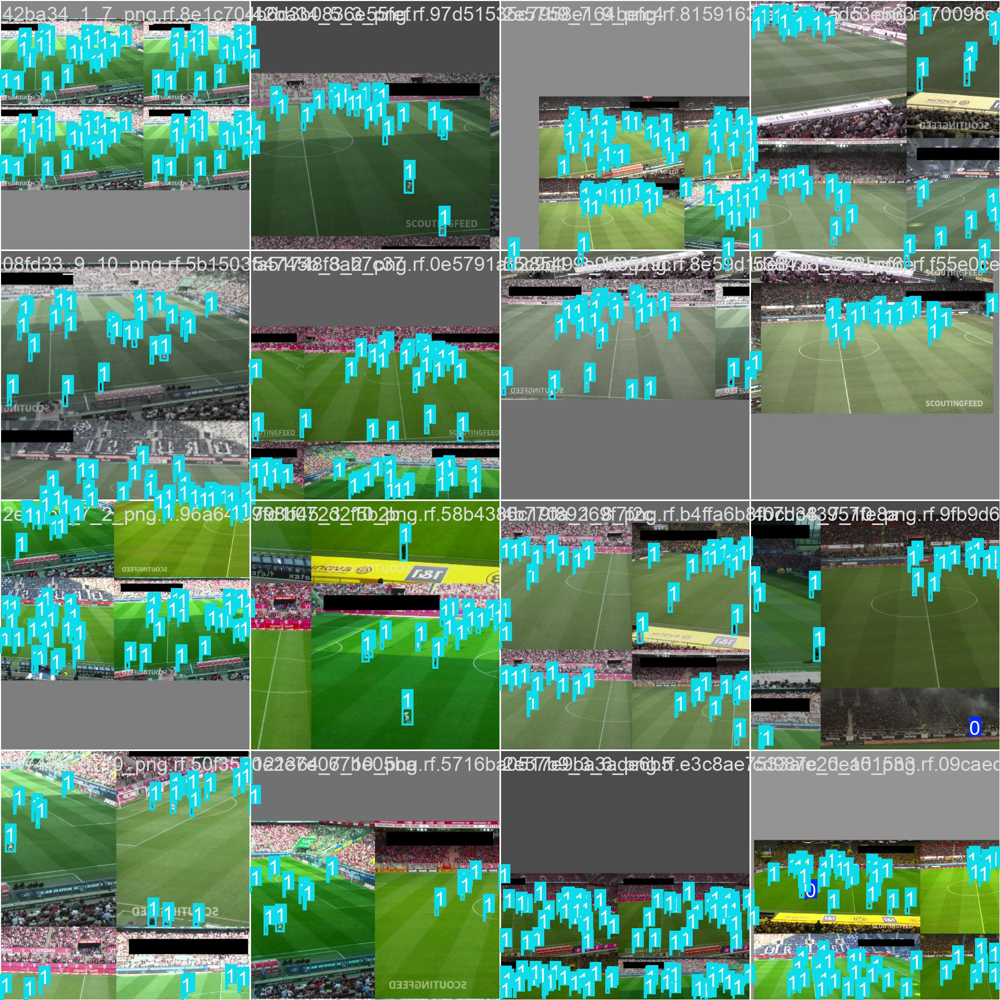

In [ ]:
Image("/content/runs/detect/train/train_batch0.jpg", width=600)

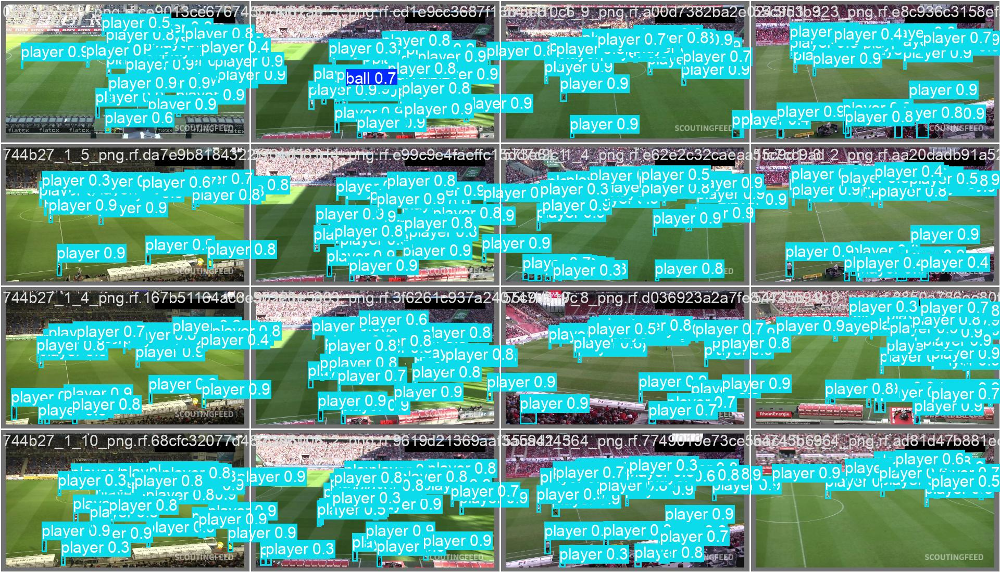

In [ ]:
Image("/content/runs/detect/train/val_batch0_pred.jpg", width=600)

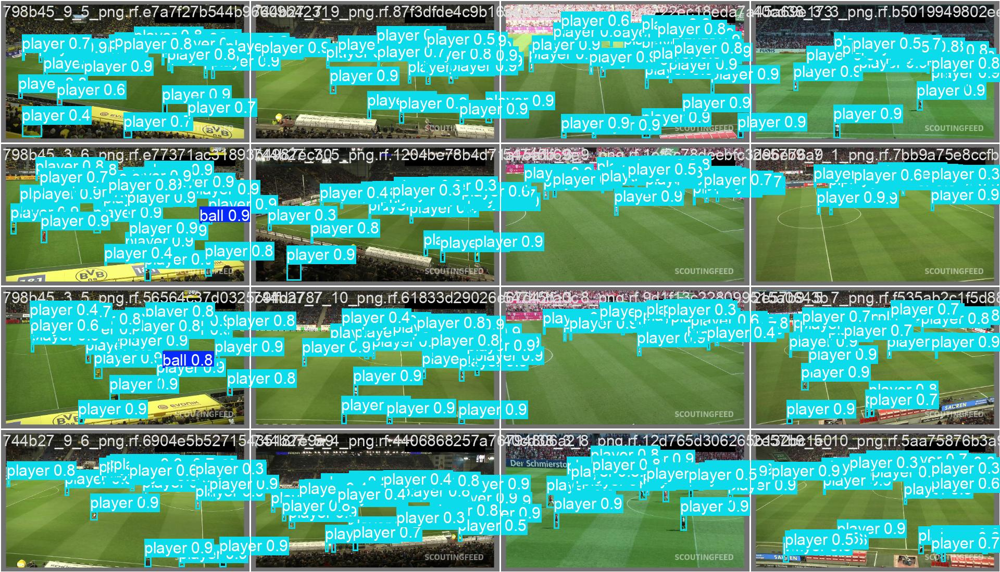

In [ ]:
Image("/content/runs/detect/train/val_batch1_pred.jpg", width=600)

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
!mv /content/runs/detect/train/weights/best.pt /content/drive/MyDrive/Yolo_V11

mv: cannot stat '/content/runs/detect/train/weights/best.pt': No such file or directory


**Download the Model Weights from local Google Drive**

In [ ]:
!gdown "https://drive.google.com/uc?id=1-H93wVNJop9tqgC50UC5Rd8BMeN6XOlO&confirm=t"

Downloading...
From: https://drive.google.com/uc?id=1-H93wVNJop9tqgC50UC5Rd8BMeN6XOlO&confirm=t
To: /content/best.pt
100% 40.5M/40.5M [00:00<00:00, 154MB/s]


**Validate the Model**

In [ ]:
!yolo task=detect mode=val model="best.pt" data={dataset.location}/data.yaml

Ultralytics 8.3.28 🚀 Python-3.10.12 torch-2.5.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLO11m summary (fused): 303 layers, 20,031,574 parameters, 0 gradients, 67.7 GFLOPs
val: Scanning /content/football-players-detection-1/valid/labels.cache... 84 images, 0 backgrounds, 0 corrupt: 100% 84/84 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% 6/6 [00:07<00:00,  1.29s/it]
                   all         84       2181      0.698      0.633      0.637       0.49
                  ball         23         23      0.487      0.304      0.295      0.164
                player         84       2158      0.909      0.961       0.98      0.816
Speed: 3.3ms preprocess, 16.4ms inference, 0.0ms loss, 14.8ms postprocess per image
Results saved to runs/detect/val
💡 Learn more at https://docs.ultralytics.com/modes/val


**Testing using Custom Model Images in Test Folder**

In [ ]:
!yolo task=detect mode=predict model= best.pt conf=0.25 source={dataset.location}/test/images save=True

Ultralytics 8.3.28 🚀 Python-3.10.12 torch-2.5.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLO11m summary (fused): 303 layers, 20,031,574 parameters, 0 gradients, 67.7 GFLOPs

image 1/28 /content/football-players-detection-1/test/images/08fd33_3_8_png.rf.165bbc5c728a76d08c0a68fe021aa8be.jpg: 384x640 28 players, 102.0ms
image 2/28 /content/football-players-detection-1/test/images/08fd33_9_6_png.rf.734a4b8b5d0e86f91abecc2b60d38b70.jpg: 384x640 1 ball, 30 players, 24.0ms
image 3/28 /content/football-players-detection-1/test/images/121364_7_3_png.rf.901c7200615e7ea5fa9105a7796b0415.jpg: 384x640 22 players, 24.0ms
image 4/28 /content/football-players-detection-1/test/images/2e57b9_1_2_png.rf.fe9215e682a1c515b1add791b6bbbb96.jpg: 384x640 24 players, 24.0ms
image 5/28 /content/football-players-detection-1/test/images/42ba34_1_2_png.rf.9bd6a74037edcadd7ea05df62bbf49a1.jpg: 384x640 28 players, 24.0ms
image 6/28 /content/football-players-detection-1/test/images/42ba34_3_2_png.rf.eabd21ce47a401422ea51912

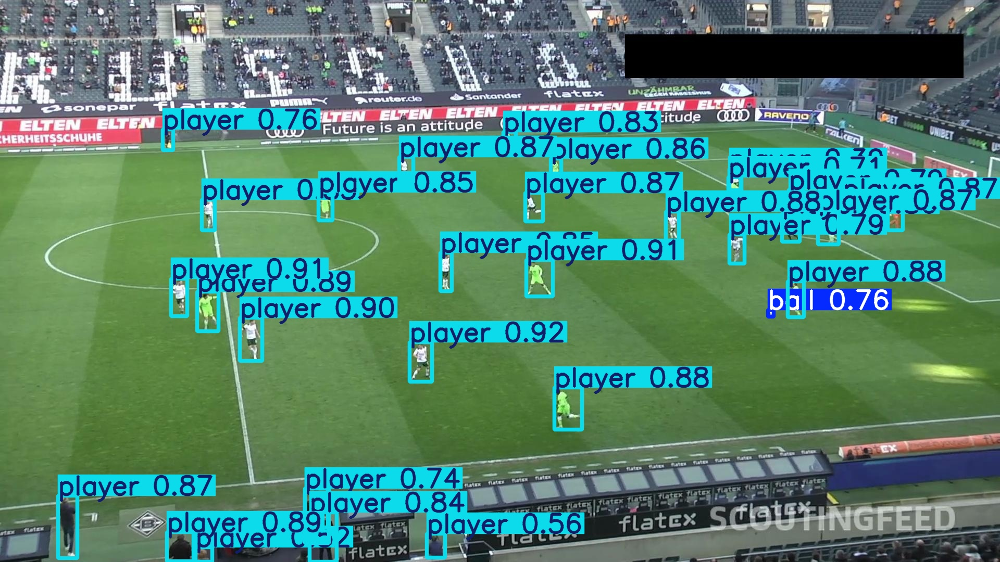

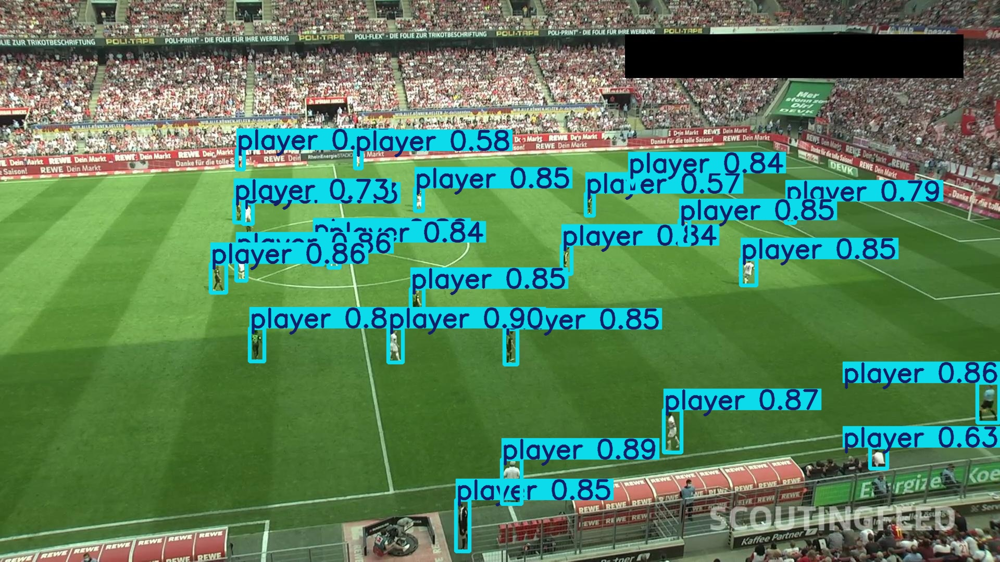

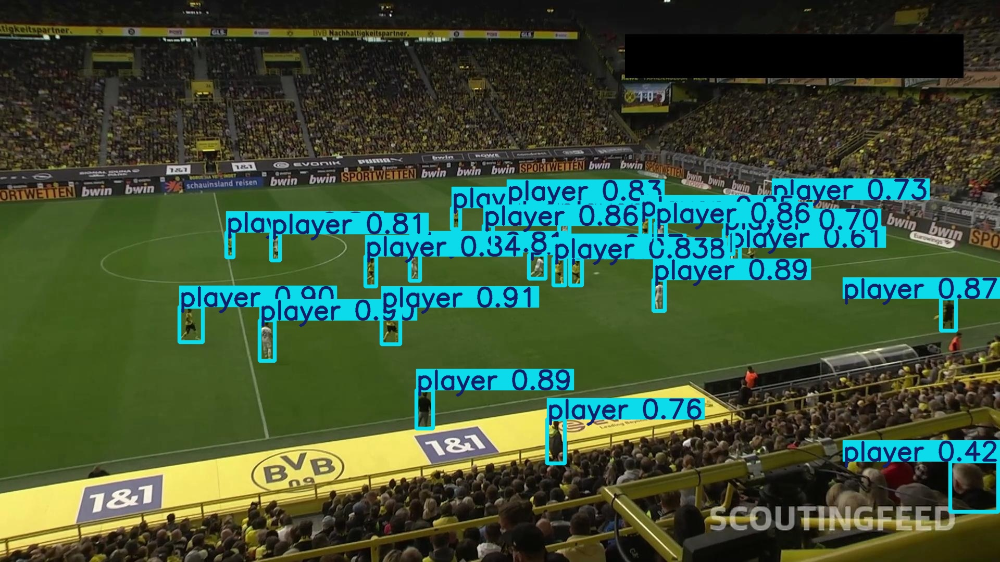

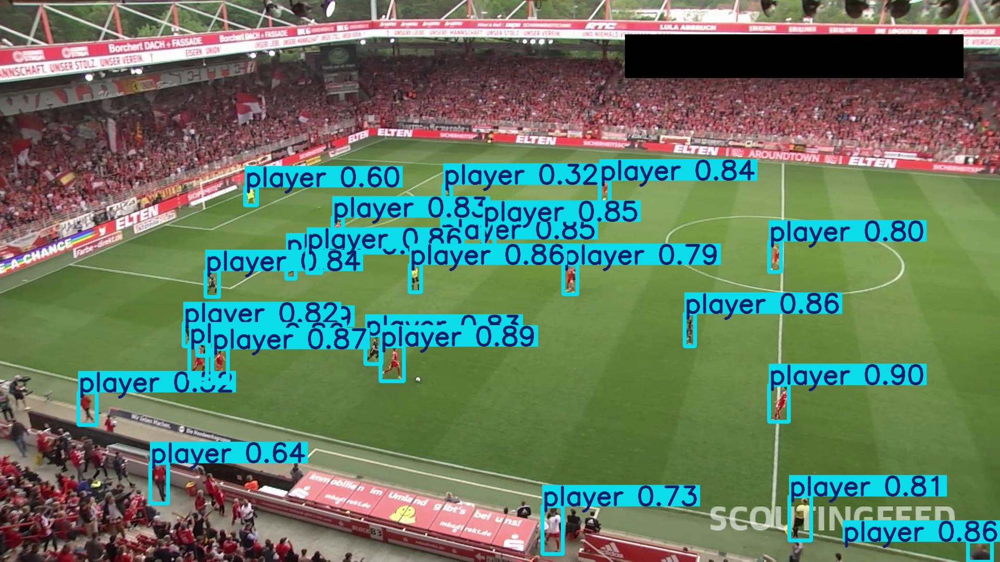

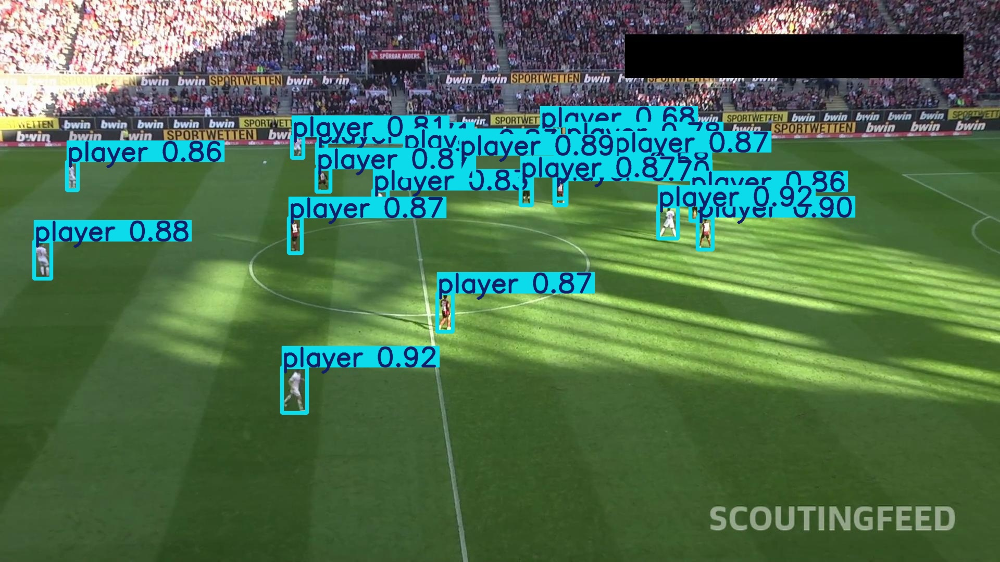

In [ ]:
import glob
import os
from IPython.display import Image as IPyImage, display

latest_folder = max(glob.glob('/content/runs/detect/predict*/'), key=os.path.getmtime)
for img in glob.glob(f'{latest_folder}/*.jpg')[1:6]:
    display(IPyImage(filename=img, width=600))
    print("\n")

**Using Custom Photo Dataset**

In [ ]:
!gdown "https://drive.google.com/uc?id=1gbRUmHdaqWU6OwJcOhvwwjsyr8nuvvsA&confirm=t"

Downloading...
From: https://drive.google.com/uc?id=1gbRUmHdaqWU6OwJcOhvwwjsyr8nuvvsA&confirm=t
To: /content/testImage.jpg
100% 770k/770k [00:00<00:00, 97.8MB/s]


In [ ]:
!yolo task=detect mode=predict model= best.pt conf=0.25 source=testImage.jpg save=True

Ultralytics 8.3.28 🚀 Python-3.10.12 torch-2.5.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLO11m summary (fused): 303 layers, 20,031,574 parameters, 0 gradients, 67.7 GFLOPs

image 1/1 /content/testImage.jpg: 352x640 14 players, 65.2ms
Speed: 2.0ms preprocess, 65.2ms inference, 664.1ms postprocess per image at shape (1, 3, 352, 640)
Results saved to runs/detect/predict2
💡 Learn more at https://docs.ultralytics.com/modes/predict


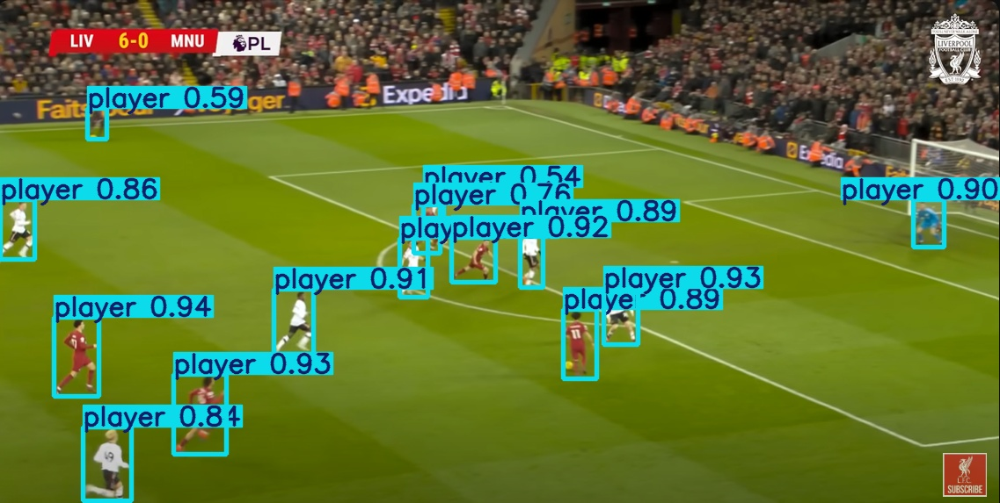

In [ ]:
Image("/content/runs/detect/predict2/testImage.jpg", width=600)

**Using Custom Video Dataset**

In [ ]:
!gdown "https://drive.google.com/uc?id=1enuKM1dENOehj33D1Ys2QypnyYjAlG_N&confirm=t"

Downloading...
From: https://drive.google.com/uc?id=1enuKM1dENOehj33D1Ys2QypnyYjAlG_N&confirm=t
To: /content/football-video.mp4
100% 29.9M/29.9M [00:00<00:00, 41.0MB/s]


In [ ]:
!yolo task=detect mode=predict model= best.pt conf=0.25 source="football-video.mp4" save=True

Ultralytics 8.3.28 🚀 Python-3.10.12 torch-2.5.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLO11m summary (fused): 303 layers, 20,031,574 parameters, 0 gradients, 67.7 GFLOPs

video 1/1 (frame 1/780) /content/football-video.mp4: 384x640 19 players, 62.2ms
video 1/1 (frame 2/780) /content/football-video.mp4: 384x640 19 players, 24.1ms
video 1/1 (frame 3/780) /content/football-video.mp4: 384x640 19 players, 24.0ms
video 1/1 (frame 4/780) /content/football-video.mp4: 384x640 19 players, 24.0ms
video 1/1 (frame 5/780) /content/football-video.mp4: 384x640 19 players, 24.0ms
video 1/1 (frame 6/780) /content/football-video.mp4: 384x640 19 players, 24.0ms
video 1/1 (frame 7/780) /content/football-video.mp4: 384x640 20 players, 24.0ms
video 1/1 (frame 8/780) /content/football-video.mp4: 384x640 20 players, 20.4ms
video 1/1 (frame 9/780) /content/football-video.mp4: 384x640 19 players, 19.7ms
video 1/1 (frame 10/780) /content/football-video.mp4: 384x640 19 players, 19.7ms
video 1/1 (frame 11/780) /conte

In [ ]:
!rm '/content/result_compressed.mp4'

rm: cannot remove '/content/result_compressed.mp4': No such file or directory


In [ ]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = '/content/runs/detect/predict3/football-video.avi'

# Compressed video path
compressed_path = "/content/result_compressed.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=800 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

In [ ]:
!cp /content/result_compressed.mp4 /content/drive/MyDrive/Yolo_V11

In [ ]:
!cp /content/runs/detect/predict2/testImage.jpg /content/drive/MyDrive/Yolo_V11